### Here I train the denoising autoencoder onto different noise levels

In [98]:
# The MNIST datasets are hosted on yann.lecun.com that has moved under CloudFlare protection
# Run this script to enable the datasets download
# Reference: https://github.com/pytorch/vision/issues/1938
from six.moves import urllib
opener = urllib.request.build_opener()
opener.addheaders = [('User-agent', 'Mozilla/5.0')]
urllib.request.install_opener(opener)

In [99]:
import torch
import numpy as np
from torchvision import datasets
import torchvision.transforms as transforms

# convert data to torch.FloatTensor
transform = transforms.ToTensor()

# load the training and test datasets
train_data = datasets.MNIST(root='~/.pytorch/MNIST_data/', train=True,
                                   download=True, transform=transform)
test_data = datasets.MNIST(root='~/.pytorch/MNIST_data/', train=False,
                                  download=True, transform=transform)

# Create training and test dataloaders
num_workers = 0
# how many samples per batch to load
batch_size = 20

# prepare data loaders
train_loader = torch.utils.data.DataLoader(train_data, batch_size=batch_size, num_workers=num_workers)
test_loader = torch.utils.data.DataLoader(test_data, batch_size=batch_size, num_workers=num_workers)

# how many samples are in train and test data
number_train_samples = len(train_loader.sampler)
number_test_samples = len(test_loader.sampler)
print(f"Number of training samples: {number_train_samples} before")
print(f"Number of test samples: {number_test_samples} before")

train_loader = torch.utils.data.DataLoader(train_data, batch_size=batch_size, num_workers=num_workers, sampler=torch.utils.data.SubsetRandomSampler(np.random.choice(number_train_samples, number_train_samples//2, replace=False)))
test_loader = torch.utils.data.DataLoader(test_data, batch_size=batch_size, num_workers=num_workers, sampler=torch.utils.data.SubsetRandomSampler(np.random.choice(number_test_samples, number_test_samples//2, replace=False)))
print(f"Number of training samples: {len(train_loader.sampler)} after")
print(f"Number of test samples: {len(test_loader.sampler)} after")

Number of training samples: 60000 before
Number of test samples: 10000 before
Number of training samples: 30000 after
Number of test samples: 5000 after


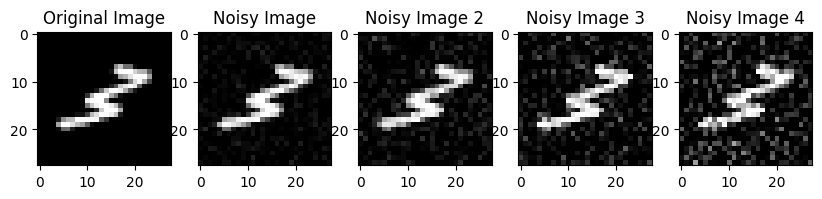

In [100]:
import matplotlib.pyplot as plt
import numpy as np

# obtain one batch of training images
dataiter = iter(train_loader)
images, labels = next(dataiter)
images = images.numpy()

# get one image from the batch
img = np.squeeze(images[0])

# Add noise to the image
noise_factor = 0.05
noisy_img = img + noise_factor * np.random.randn(*img.shape)
noisy_img = np.clip(noisy_img, 0., 1.)

# Add even more noise to the image
noise_factor = 0.1
noisy_img2 = img + noise_factor * np.random.randn(*img.shape)
noisy_img2 = np.clip(noisy_img2, 0., 1.)

# Add even more noise to the image
noise_factor = 0.15
noisy_img3 = img + noise_factor * np.random.randn(*img.shape)
noisy_img3 = np.clip(noisy_img3, 0., 1.)

# Add even more noise to the image
noise_factor = 0.2
noisy_img4 = img + noise_factor * np.random.randn(*img.shape)
noisy_img4 = np.clip(noisy_img4, 0., 1.)

# Plot the original and the two noisy images side by side
fig, axes = plt.subplots(1, 5, figsize=(10, 5))
#fig, axes = plt.subplots(1, 2, figsize=(10, 5))

axes[0].imshow(img, cmap='gray')
axes[0].set_title('Original Image')

axes[1].imshow(noisy_img, cmap='gray')
axes[1].set_title('Noisy Image')

axes[2].imshow(noisy_img2, cmap='gray')
axes[2].set_title('Noisy Image 2')

axes[3].imshow(noisy_img3, cmap='gray')
axes[3].set_title('Noisy Image 3')

axes[4].imshow(noisy_img4, cmap='gray')
axes[4].set_title('Noisy Image 4')

plt.show()

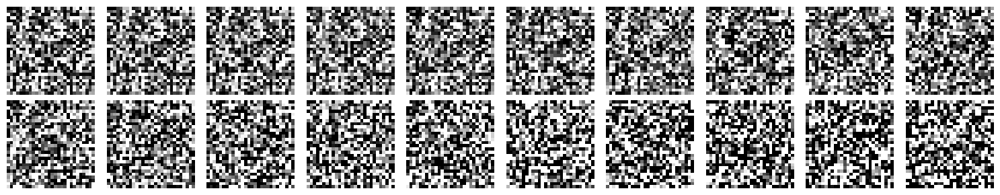

In [249]:
import matplotlib.pyplot as plt
import numpy as np

# Set the number of noisy images to generate
num_images = 20

# Initialize a list to store the noisy images
noisy_img_list = []

# obtain one batch of training images
dataiter = iter(train_loader)
images, labels = next(dataiter)
images = images.numpy()

# get one image from the batch
img = np.squeeze(images[0])

# Add noise to the original image multiple times
for i in range(num_images):
    noise_factor = 0.05 * (i + 1)  # Increase noise factor with each iteration
    noisy_img = np.clip(img + noise_factor * np.random.randn(*img.shape), 0., 1.)
    noisy_img_list.append(noisy_img)

# Convert the list of images into a numpy array
noisy_img_array = np.array(noisy_img_list)

# Plot the images in a 2x10 grid
fig, axes = plt.subplots(2, 10, figsize=(15, 3))
for i in range(2):
    for j in range(10):
        axes[i, j].imshow(noisy_img_array[i * 10 + j], cmap='gray')
        axes[i, j].axis('off')
plt.tight_layout()
plt.show()




In [231]:
from torch.utils.data import TensorDataset, DataLoader

# Initialize lists to store x_train (noisy images) and y_train_images (original images)
x_train = []
y_train = []

# Collect noisy and original images
for data in train_loader:
    # _ stands in for labels, here
    # no need to flatten images
    images, _ = data
    
    # add random noise to the input images
    noise_factor = 0.45
    noisy_imgs = images + noise_factor * torch.randn(*images.shape)
    # Clip the images to be between 0 and 1
    noisy_imgs = np.clip(noisy_imgs, 0., 1.)
    
    # add random noise to the input images
    noise_factor = 0.5
    noisy_imgs2 = images + noise_factor * torch.randn(*images.shape)
    # Clip the images to be between 0 and 1
    noisy_imgs2 = np.clip(noisy_imgs2, 0., 1.)
    
    # Append noisy images to x_train
    x_train.append(noisy_imgs2.numpy())
    
    # Append original images to y_train_images
    y_train.append(noisy_imgs.numpy())

# Convert lists to numpy arrays
x_train = np.concatenate(x_train, axis=0)
y_train = np.concatenate(y_train, axis=0)

# Transform to torch tensors
x_train = torch.Tensor(x_train)
y_train = torch.Tensor(y_train).squeeze(0).unsqueeze(-1)

print('The size of x_train is ', x_train.shape)
print('The size of y_train is ', y_train.shape)

# Create Loaders
batch_size = 20

train_dataset = TensorDataset(x_train, y_train)  # create your dataset
train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)

# Initialize lists to store x_test (noisy images) and y_test_images (original images)
x_test = []
y_test = []

# Collect noisy and original images from the test set
for data in test_loader:
    # _ stands in for labels, here
    # no need to flatten images
    images, _ = data
    
    # add random noise to the input images
    noise_factor = 0.45
    noisy_imgs = images + noise_factor * torch.randn(*images.shape)
    # Clip the images to be between 0 and 1
    noisy_imgs = np.clip(noisy_imgs, 0., 1.)
    
    # add random noise to the input images
    noise_factor = 0.5
    noisy_imgs2 = images + noise_factor * torch.randn(*images.shape)
    # Clip the images to be between 0 and 1
    noisy_imgs2 = np.clip(noisy_imgs2, 0., 1.)
    
    # Append noisy images to x_test
    x_test.append(noisy_imgs2.numpy())
    
    # Append original images to y_test_images
    y_test.append(noisy_imgs.numpy())

# Convert lists to numpy arrays
x_test = np.concatenate(x_test, axis=0)
y_test = np.concatenate(y_test, axis=0)

# Transform to torch tensors
x_test = torch.Tensor(x_test)
y_test = torch.Tensor(y_test).squeeze(0).unsqueeze(-1)

print('The size of x_test is ', x_test.shape)
print('The size of y_test is ', y_test.shape)

# Create Loaders
test_dataset = TensorDataset(x_test, y_test)  # create your dataset
test_loader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False)  # not use minibatch


The size of x_train is  torch.Size([30000, 1, 28, 28])
The size of y_train is  torch.Size([30000, 1, 28, 28, 1])
The size of x_test is  torch.Size([5000, 1, 28, 28])
The size of y_test is  torch.Size([5000, 1, 28, 28, 1])


In [232]:
# Create the tp dictionary but with only the stuff we actually use
tp = {}
tp['x_0'] = x_train
tp['y'] = y_train
tp['prior'] = 'L2' # L2 regularization
tp['prior_W'] = 'L2'
tp['prior_b'] = 'L2'

In [234]:
from scipy.io import loadmat

path = 'Params/Noise_0.5/'

# Load the weights and biases from .mat files
conv1_weight_loaded = torch.from_numpy(loadmat(path + 'conv1_weight.mat')['conv1_weight'])
conv1_bias_loaded = torch.squeeze(torch.from_numpy(loadmat(path + 'conv1_bias.mat')['conv1_bias']))

conv2_weight_loaded = torch.from_numpy(loadmat(path + 'conv2_weight.mat')['conv2_weight'])
conv2_bias_loaded = torch.squeeze(torch.from_numpy(loadmat(path + 'conv2_bias.mat')['conv2_bias']))

conv3_weight_loaded = torch.from_numpy(loadmat(path + 'conv3_weight.mat')['conv3_weight'])
conv3_bias_loaded = torch.squeeze(torch.from_numpy(loadmat(path + 'conv3_bias.mat')['conv3_bias']))

t_conv1_weight_loaded = torch.from_numpy(loadmat(path + 't_conv1_weight.mat')['t_conv1_weight'])
t_conv1_bias_loaded = torch.squeeze(torch.from_numpy(loadmat(path + 't_conv1_bias.mat')['t_conv1_bias']))

t_conv2_weight_loaded = torch.from_numpy(loadmat(path + 't_conv2_weight.mat')['t_conv2_weight'])
t_conv2_bias_loaded = torch.squeeze(torch.from_numpy(loadmat(path + 't_conv2_bias.mat')['t_conv2_bias']))

t_conv3_weight_loaded = torch.from_numpy(loadmat(path + 't_conv3_weight.mat')['t_conv3_weight'])
t_conv3_bias_loaded = torch.squeeze(torch.from_numpy(loadmat(path + 't_conv3_bias.mat')['t_conv3_bias']))

conv_out_weight_loaded = torch.from_numpy(loadmat(path + 'conv_out_weight.mat')['conv_out_weight'])
conv_out_bias_loaded = torch.squeeze(torch.from_numpy(loadmat(path + 'conv_out_bias.mat')['conv_out_bias']), dim=0)


print("conv1_weight_loaded shape:", conv1_weight_loaded.shape)
print("conv1_bias_loaded shape:", conv1_bias_loaded.shape)

print("conv2_weight_loaded shape:", conv2_weight_loaded.shape)
print("conv2_bias_loaded shape:", conv2_bias_loaded.shape)

print("conv3_weight_loaded shape:", conv3_weight_loaded.shape)
print("conv3_bias_loaded shape:", conv3_bias_loaded.shape)

print("t_conv1_weight_loaded shape:", t_conv1_weight_loaded.shape)
print("t_conv1_bias_loaded shape:", t_conv1_bias_loaded.shape)

print("t_conv2_weight_loaded shape:", t_conv2_weight_loaded.shape)
print("t_conv2_bias_loaded shape:", t_conv2_bias_loaded.shape)

print("t_conv3_weight_loaded shape:", t_conv3_weight_loaded.shape)
print("t_conv3_bias_loaded shape:", t_conv3_bias_loaded.shape)

print("conv_out_weight_loaded shape:", conv_out_weight_loaded.shape)
print("conv_out_bias_loaded shape:", conv_out_bias_loaded.shape)

# Save them in a W and in a b dictionary
W = {}
b = {}

W['conv1'] = conv1_weight_loaded
W['conv2'] = conv2_weight_loaded
W['conv3'] = conv3_weight_loaded
W['t_conv1'] = t_conv1_weight_loaded
W['t_conv2'] = t_conv2_weight_loaded
W['t_conv3'] = t_conv3_weight_loaded
W['conv_out'] = conv_out_weight_loaded

b['conv1'] = conv1_bias_loaded
b['conv2'] = conv2_bias_loaded
b['conv3'] = conv3_bias_loaded
b['t_conv1'] = t_conv1_bias_loaded
b['t_conv2'] = t_conv2_bias_loaded
b['t_conv3'] = t_conv3_bias_loaded
b['conv_out'] = conv_out_bias_loaded

conv1_weight_loaded shape: torch.Size([32, 1, 3, 3])
conv1_bias_loaded shape: torch.Size([32])
conv2_weight_loaded shape: torch.Size([16, 32, 3, 3])
conv2_bias_loaded shape: torch.Size([16])
conv3_weight_loaded shape: torch.Size([8, 16, 3, 3])
conv3_bias_loaded shape: torch.Size([8])
t_conv1_weight_loaded shape: torch.Size([8, 8, 3, 3])
t_conv1_bias_loaded shape: torch.Size([8])
t_conv2_weight_loaded shape: torch.Size([8, 16, 2, 2])
t_conv2_bias_loaded shape: torch.Size([16])
t_conv3_weight_loaded shape: torch.Size([16, 32, 2, 2])
t_conv3_bias_loaded shape: torch.Size([32])
conv_out_weight_loaded shape: torch.Size([1, 32, 3, 3])
conv_out_bias_loaded shape: torch.Size([1])


In [235]:
# create est_ml tensor
import torch

# Corrected shapes of the parameters
conv1_weight_shape = (32, 1, 3, 3)
conv1_bias_shape = (32,)  
conv2_weight_shape = (16, 32, 3, 3)
conv2_bias_shape = (16,)  
conv3_weight_shape = (8, 16, 3, 3)
conv3_bias_shape = (8,)  
t_conv1_weight_shape = (8, 8, 3, 3)
t_conv1_bias_shape = (8,)  
t_conv2_weight_shape = (8, 16, 2, 2)
t_conv2_bias_shape = (16,)  
t_conv3_weight_shape = (16, 32, 2, 2)
t_conv3_bias_shape = (32,)  
conv_out_weight_shape = (1, 32, 3, 3)
conv_out_bias_shape = (1,)  



# List of all parameters
parameters = [
    conv1_weight_loaded, conv1_bias_loaded,
    conv2_weight_loaded, conv2_bias_loaded,
    conv3_weight_loaded, conv3_bias_loaded,
    t_conv1_weight_loaded, t_conv1_bias_loaded,
    t_conv2_weight_loaded, t_conv2_bias_loaded,
    t_conv3_weight_loaded, t_conv3_bias_loaded,
    conv_out_weight_loaded, conv_out_bias_loaded
]

# Concatenate and reshape into a single tensor
est_ml = torch.cat([param.reshape(-1) for param in parameters], dim=0).unsqueeze(1)

print("est_ml Shape:", est_ml.shape)

est_ml Shape: torch.Size([9585, 1])


In [236]:
#parameters for our algorithm
N = 10# number of proposals #50
K = 10  # samples per proposal per iteration #100
sig_prop = 0.001
lr = 2  #glocal resampling
gr_period=2
tp['regularization_weight'] = 0 #0.07739783490124956
epsilon1 = 1e-50
epsilon2 = 1e-50
T = 5

In [237]:
from PMCnet import SL_PMC_Adapt_Cov_new

output_noise_05 = SL_PMC_Adapt_Cov_new(train_loader,N,K,T,sig_prop,lr,gr_period,tp,est_ml,epsilon1,epsilon2)

Starting Iteration 0


/Users/florianwittstock/Documents/VS Studio Code/PMCnet-denoiser/PMCnet.py:72: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  a = proposals_temp[:,n].unsqueeze(-1).repeat(1, K)+torch.randn(M_,K).cpu()*torch.tensor(Sigma_temp[:,n]**(1/2)).unsqueeze(-1).float().cpu()


Completed evaluation of sample 0 of 100 for iteration 0
Completed evaluation of sample 1 of 100 for iteration 0
Completed evaluation of sample 2 of 100 for iteration 0
Completed evaluation of sample 3 of 100 for iteration 0
Completed evaluation of sample 4 of 100 for iteration 0
Completed evaluation of sample 5 of 100 for iteration 0
Completed evaluation of sample 6 of 100 for iteration 0
Completed evaluation of sample 7 of 100 for iteration 0
Completed evaluation of sample 8 of 100 for iteration 0
Completed evaluation of sample 9 of 100 for iteration 0
Completed evaluation of sample 10 of 100 for iteration 0
Completed evaluation of sample 11 of 100 for iteration 0
Completed evaluation of sample 12 of 100 for iteration 0
Completed evaluation of sample 13 of 100 for iteration 0
Completed evaluation of sample 14 of 100 for iteration 0
Completed evaluation of sample 15 of 100 for iteration 0
Completed evaluation of sample 16 of 100 for iteration 0
Completed evaluation of sample 17 of 100 

/Users/florianwittstock/Documents/VS Studio Code/PMCnet-denoiser/functions.py:279: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  w = torch.tensor(w).cpu()


Keys in W_g: dict_keys(['conv1.weight', 'conv2.weight', 'conv3.weight', 't_conv1.weight', 't_conv2.weight', 't_conv3.weight', 'conv_out.weight'])
Keys in B_g: dict_keys(['conv1.bias', 'conv2.bias', 'conv3.bias', 't_conv1.bias', 't_conv2.bias', 't_conv3.bias', 'conv_out.bias'])
Keys in W_g: dict_keys(['conv1.weight', 'conv2.weight', 'conv3.weight', 't_conv1.weight', 't_conv2.weight', 't_conv3.weight', 'conv_out.weight'])
Keys in B_g: dict_keys(['conv1.bias', 'conv2.bias', 'conv3.bias', 't_conv1.bias', 't_conv2.bias', 't_conv3.bias', 'conv_out.bias'])
Keys in W_g: dict_keys(['conv1.weight', 'conv2.weight', 'conv3.weight', 't_conv1.weight', 't_conv2.weight', 't_conv3.weight', 'conv_out.weight'])
Keys in B_g: dict_keys(['conv1.bias', 'conv2.bias', 'conv3.bias', 't_conv1.bias', 't_conv2.bias', 't_conv3.bias', 'conv_out.bias'])
Keys in W_g: dict_keys(['conv1.weight', 'conv2.weight', 'conv3.weight', 't_conv1.weight', 't_conv2.weight', 't_conv3.weight', 'conv_out.weight'])
Keys in B_g: dict_ke

In [238]:
output_dict_noise_05 = {}
output_dict_noise_05['Mean_est_evolution'] = output_noise_05[0]
output_dict_noise_05['Z_est_evolution'] = output_noise_05[1]
output_dict_noise_05['all_samples'] = output_noise_05[2]
output_dict_noise_05['all_weights'] = output_noise_05[3]
output_dict_noise_05['all_proposals'] = output_noise_05[4]
output_dict_noise_05['all_Sigma'] = output_noise_05[5]
output_dict_noise_05['mean_est_part'] = output_noise_05[6]
output_dict_noise_05['Z_part'] = output_noise_05[7]
output_dict_noise_05['m2_est_evolution'] = output_noise_05[8]
output_dict_noise_05['m2_part'] = output_noise_05[9]
output_dict_noise_05['samples_resampled_adapted'] = output_noise_05[10]
output_dict_noise_05['Sigma_resampled'] = output_noise_05[11]
output_dict_noise_05['logf_saved'] = output_noise_05[12]


In [239]:
import json
import os
import torch
import numpy as np

# Create a custom encoder to handle tensors and NumPy arrays
class CustomEncoder(json.JSONEncoder):
    def default(self, obj):
        if isinstance(obj, torch.Tensor):
            return obj.detach().cpu().numpy().tolist()
        elif isinstance(obj, np.ndarray):
            return obj.tolist()
        return json.JSONEncoder.default(self, obj)

# Create the output folder if it doesn't exist
output_folder = 'output'
if not os.path.exists(output_folder):
    os.makedirs(output_folder)

# Define the output file path
output_file = os.path.join(output_folder, 'output_dict_noise_05.json')

# Save the output_dict_2 dictionary to a JSON file using custom encoder
with open(output_file, 'w') as f:
    json.dump(output_dict_noise_05, f, cls=CustomEncoder)

print("Output dictionary saved to:", output_file)


Output dictionary saved to: output/output_dict_noise_05.json


In [240]:
# load output_dict.json
import json

# Define the path to the JSON file
output_file_path = 'output/output_dict_noise_05.json'

# Load the content of the JSON file into output_dict_loaded
with open(output_file_path, 'r') as f:
    output_dict_loaded_noise_05 = json.load(f)

# Display the loaded dictionary
print("output_dict_noise_05_loaded")


output_dict_noise_05_loaded


In [241]:
import torch

# Define a function to convert lists to tensors
def list_to_tensor(obj):
    if isinstance(obj, list):
        # Convert the list to a tensor
        return torch.tensor(obj)
    else:
        return obj

# Iterate over keys of output_dict_loaded_tensors
for key, value in output_dict_loaded_noise_05.items():
    # Check if the key is 'all_weights' or 'all_samples'
    if key in ['all_weights', 'all_samples']:
        # Convert the corresponding list to a tensor
        output_dict_loaded_noise_05[key] = list_to_tensor(value)

# Verify the conversion by printing the modified dictionary
print("Modified output_dict_noise_05_loaded done")


Modified output_dict_noise_05_loaded done


In [242]:
# get samples and weights
samples_vector = output_dict_loaded_noise_05['all_samples']
weights_vector = output_dict_loaded_noise_05['all_weights']

samples_vector.shape, weights_vector.shape 

(torch.Size([5, 9585, 100]), torch.Size([5, 100]))

In [243]:
weights = weights_vector[-1,:]
samples = samples_vector[-1,:,:]

weights.shape, samples.shape

(torch.Size([100]), torch.Size([9585, 100]))

In [244]:
from functions import *
import numpy as np
from DenoisingNetwork import ConvDenoiser   

N_resampled = 1
weights = np.nan_to_num(weights)
wn = weights/sum(weights)

positions = np.random.choice([i for i in range(N*K)], N_resampled, replace = True, p = wn )
parameter_vec = samples[:,positions]

[W,b] = Vec2param(parameter_vec)

# Instantiate your ConvDenoiser model
model = ConvDenoiser()

# Load your weights and biases into the model
model.conv1.weight.data = W['conv1']
model.conv1.bias.data = b['conv1']
model.conv2.weight.data = W['conv2']
model.conv2.bias.data = b['conv2']
model.conv3.weight.data = W['conv3']
model.conv3.bias.data = b['conv3']
model.t_conv1.weight.data = W['t_conv1']
model.t_conv1.bias.data = b['t_conv1']
model.t_conv2.weight.data = W['t_conv2']
model.t_conv3.weight.data = W['t_conv3']
model.conv_out.weight.data = W['conv_out']
model.conv_out.bias.data = b['conv_out']

batch_size = 100

# Split X into batches
X_batches = torch.split(x_test, batch_size, dim=0)

# Process each batch separately
outputs = []
ct = 0
for batch in X_batches:
    ct = ct + 1
    batch_output = model(batch)
    outputs.append(batch_output)
    #print(f'Done with batch number {ct}')

# Concatenate the results along the first dimension
model_output = torch.cat(outputs, dim=0)


model_output.shape


torch.Size([5000, 1, 28, 28])

In [245]:
# output is resized into a batch of images
model_output_view = model_output[:20,:,:,:].view(20, 1, 28, 28)
# use detach when it's an output that requires_grad
model_output_view = model_output_view.detach().numpy()

In [246]:
noisy_images = x_test.numpy()

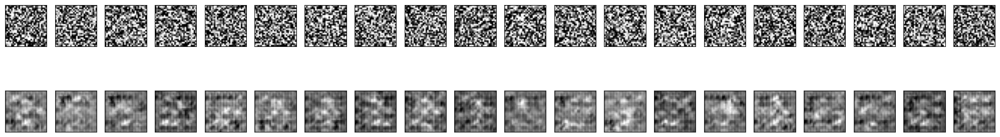

In [247]:
# plot the first twenty input images and then reconstructed images
fig, axes = plt.subplots(nrows=2, ncols=20, sharex=True, sharey=True, figsize=(25, 4))

# input images on the top row, reconstructions on the bottom
for i in range(20):
    axes[0, i].imshow(np.squeeze(noisy_images[i]), cmap='gray')
    axes[0, i].get_xaxis().set_visible(False)
    axes[0, i].get_yaxis().set_visible(False)
    
    axes[1, i].imshow(np.squeeze(model_output_view[i]), cmap='gray')
    axes[1, i].get_xaxis().set_visible(False)
    axes[1, i].get_yaxis().set_visible(False)

plt.show()
